<a href="https://colab.research.google.com/github/noreenanwar/research/blob/master/object_detection_H.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Object Detection

In this tutorial, you will learn:
- the basic structure of Faster R-CNN.
- to perform inference with a MMDetection detector.
- to train a new detector with a new dataset.

Let's start!


## Install MMDetection

In [47]:
# Check nvcc version
!nvcc -V
# Check GCC version
!gcc --version

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2022 NVIDIA Corporation
Built on Wed_Sep_21_10:33:58_PDT_2022
Cuda compilation tools, release 11.8, V11.8.89
Build cuda_11.8.r11.8/compiler.31833905_0
gcc (Ubuntu 9.4.0-1ubuntu1~20.04.1) 9.4.0
Copyright (C) 2019 Free Software Foundation, Inc.
This is free software; see the source for copying conditions.  There is NO
warranty; not even for MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE.



In [48]:
# install dependencies: (use cu111 because colab has CUDA 11.1)
!pip install torch==1.9.0+cu111 torchvision==0.10.0+cu111 -f https://download.pytorch.org/whl/torch_stable.html

# install mmcv-full thus we could use CUDA operators
!pip install mmcv-full -f https://download.openmmlab.com/mmcv/dist/cu111/torch1.9.0/index.html

# Install mmdetection
!rm -rf mmdetection
!git clone https://github.com/open-mmlab/mmdetection.git
%cd mmdetection

!pip install -e .

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in links: https://download.pytorch.org/whl/torch_stable.html
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in links: https://download.openmmlab.com/mmcv/dist/cu111/torch1.9.0/index.html
Cloning into 'mmdetection'...
remote: Enumerating objects: 35247, done.
remote: Counting objects: 100% (69/69), done.
remote: Compressing objects: 100% (65/65), done.
remote: Total 35247 (delta 19), reused 35 (delta 4), pack-reused 35178
Receiving objects: 100% (35247/35247), 47.22 MiB | 18.25 MiB/s, done.
Resolving deltas: 100% (24855/24855), done.
/content/mmdetection/mmdetection
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Obtaining file:///content/mmdetection/mmdetection
  Preparing metadata (setup.py) ... done
  Attempting uninstall: mmdet
    Found existing installation: mmdet 2.

In [49]:
from mmcv import collect_env
collect_env()

{'sys.platform': 'linux',
 'Python': '3.9.16 (main, Dec  7 2022, 01:11:51) [GCC 9.4.0]',
 'CUDA available': True,
 'GPU 0': 'Tesla T4',
 'CUDA_HOME': '/usr/local/cuda',
 'NVCC': 'Cuda compilation tools, release 11.8, V11.8.89',
 'GCC': 'x86_64-linux-gnu-gcc (Ubuntu 9.4.0-1ubuntu1~20.04.1) 9.4.0',
 'PyTorch': '1.9.0+cu111',
 'PyTorch compiling details': 'PyTorch built with:\n  - GCC 7.3\n  - C++ Version: 201402\n  - Intel(R) Math Kernel Library Version 2020.0.0 Product Build 20191122 for Intel(R) 64 architecture applications\n  - Intel(R) MKL-DNN v2.1.2 (Git Hash 98be7e8afa711dc9b66c8ff3504129cb82013cdb)\n  - OpenMP 201511 (a.k.a. OpenMP 4.5)\n  - NNPACK is enabled\n  - CPU capability usage: AVX2\n  - CUDA Runtime 11.1\n  - NVCC architecture flags: -gencode;arch=compute_37,code=sm_37;-gencode;arch=compute_50,code=sm_50;-gencode;arch=compute_60,code=sm_60;-gencode;arch=compute_70,code=sm_70;-gencode;arch=compute_75,code=sm_75;-gencode;arch=compute_80,code=sm_80;-gencode;arch=compute_86,c

In [50]:
# Check Pytorch installation
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())

# Check MMDetection installation
import mmdet
print(mmdet.__version__)

# Check mmcv installation
from mmcv.ops import get_compiling_cuda_version, get_compiler_version
print(get_compiling_cuda_version())
print(get_compiler_version())

1.9.0+cu111 True
2.28.2
11.1
GCC 7.3


In [51]:
# We download the pre-trained checkpoints for inference and finetuning.
!mkdir checkpoints
!wget -c https://download.openmmlab.com/mmdetection/v2.0/centernet/centernet_resnet18_dcnv2_140e_coco/centernet_resnet18_dcnv2_140e_coco_20210702_155131-c8cd631f.pth \
-O checkpoints/centernet_resnet18_dcnv2_140e_coco_20210702_155131-c8cd631f.pth

--2023-04-03 18:35:03--  https://download.openmmlab.com/mmdetection/v2.0/centernet/centernet_resnet18_dcnv2_140e_coco/centernet_resnet18_dcnv2_140e_coco_20210702_155131-c8cd631f.pth
Resolving download.openmmlab.com (download.openmmlab.com)... 47.246.48.210, 47.246.48.204, 47.246.48.205, ...
Connecting to download.openmmlab.com (download.openmmlab.com)|47.246.48.210|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 57832952 (55M) [application/octet-stream]
Saving to: ‘checkpoints/centernet_resnet18_dcnv2_140e_coco_20210702_155131-c8cd631f.pth’

checkpoints/centern 100%[===================>]  55.15M  36.1MB/s    in 1.5s    

2023-04-03 18:35:05 (36.1 MB/s) - ‘checkpoints/centernet_resnet18_dcnv2_140e_coco_20210702_155131-c8cd631f.pth’ saved [57832952/57832952]



In [ ]:
pwd

'/content/mmdetection'

In [52]:
import mmcv
from mmcv.runner import load_checkpoint

from mmdet.apis import inference_detector, show_result_pyplot
from mmdet.models import build_detector

# Choose to use a config and initialize the detector
config = 'configs/centernet/centernet_resnet18_dcnv2_140e_coco.py'
# Setup a checkpoint file to load
checkpoint = 'checkpoints/centernet_resnet18_dcnv2_140e_coco_20210702_155131-c8cd631f.pth'

# Set the device to be used for evaluation
device='cuda:0'

# Load the config
config = mmcv.Config.fromfile(config)
# Set pretrained to be None since we do not need pretrained model here
config.model.pretrained = None

# Initialize the detector
model = build_detector(config.model)

# Load checkpoint
checkpoint = load_checkpoint(model, checkpoint, map_location=device)

# Set the classes of models for inference
model.CLASSES = checkpoint['meta']['CLASSES']

# We need to set the model's cfg for inference
model.cfg = config

# Convert the model to GPU
model.to(device)
# Convert the model into evaluation mode
model.eval()

load checkpoint from local path: checkpoints/centernet_resnet18_dcnv2_140e_coco_20210702_155131-c8cd631f.pth


CenterNet(
  (backbone): ResNet(
    (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): ResLayer(
      (0): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
      )
      (1): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_ru

In [53]:
from google.colab import drive
drive.mount('/content/drive')
import shutil
shutil.copy("/content/drive/MyDrive/MOT17.mp4","/content/mmdetection/demo")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


'/content/mmdetection/demo/MOT17.mp4'

From the printed model, we will find that the model does consist of the components that we described earlier. It uses ResNet as its CNN backbone, and has a RPN head and RoI Head. In addition, the model has a neural network module, named neck, directly after the CNN backbone. It is a [feature pyramid network (FPN)](https://arxiv.org/abs/1612.03144) for enhancing the multi-scale features.


### Inference the detector

Since the model is successfully created and loaded, let's see how good it is. We use the high-level API `inference_detector` implemented in the MMDetection. This API is created to ease the inference process. The details of the codes can be found [here](https://github.com/open-mmlab/mmdetection/blob/master/mmdet/apis/inference.py#L15).

In [56]:
import cv2
import os

# Path to the video file
video_file = "demo/MOT17.mp4"


# Create a directory to save the images
os.makedirs("frames", exist_ok=True)

# Open the video file
video = cv2.VideoCapture(video_file)
print("nnn")

# Get the total number of frames in the video
total_frames = int(video.get(cv2.CAP_PROP_FRAME_COUNT))

# Loop through all the frames in the video
for i in range(total_frames):
    # Read the next frame from the video
    success, frame = video.read()
    
    # If the frame was successfully read, save it as an image
    if success:
        image_file = "frames/frame_{:05d}.jpg".format(i)
        cv2.imwrite(image_file, frame)

# Release the video capture object
video.release()

nnn


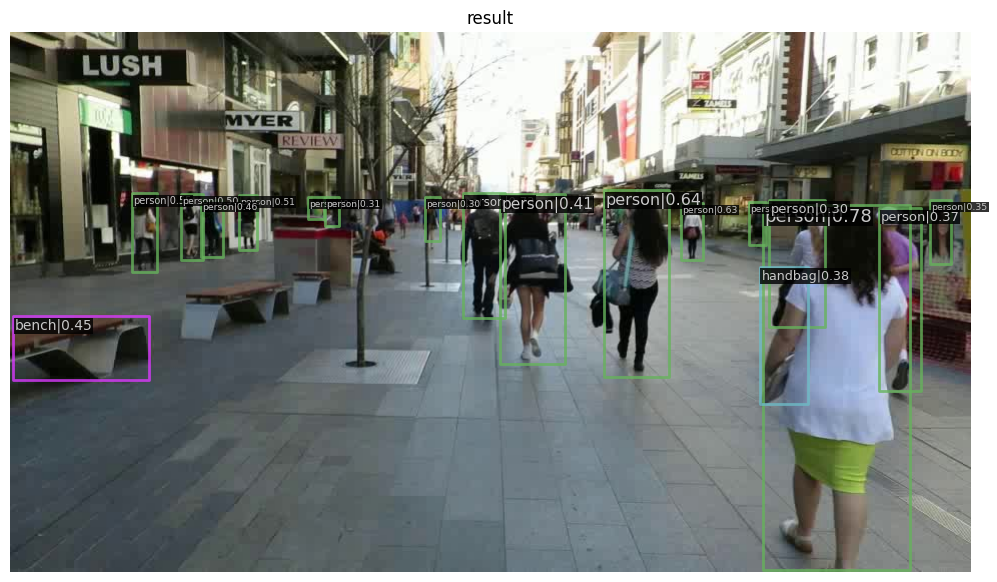

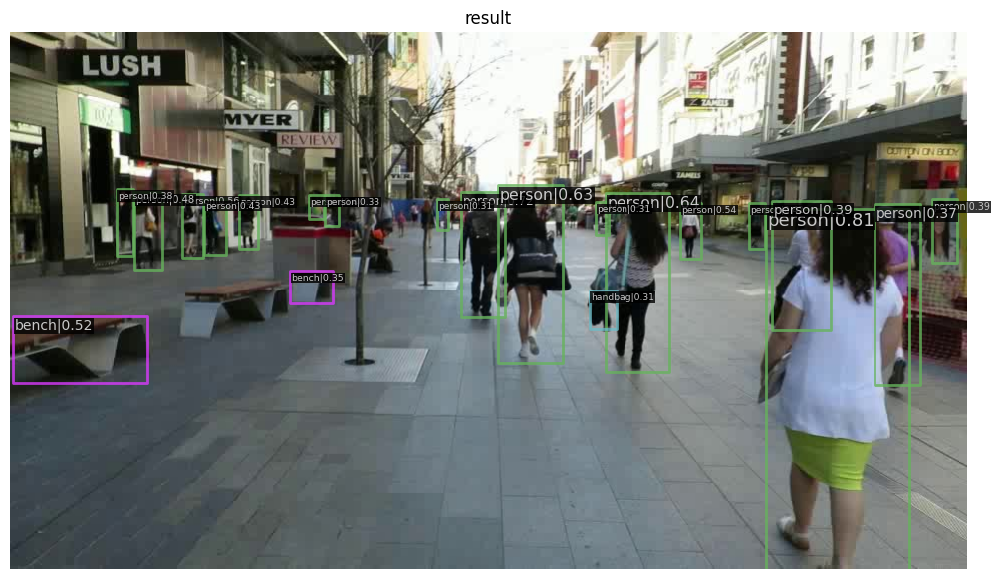

[[7.99483597e-01 1.84221998e-01 9.56342876e-01 5.72546363e-01
  6.90521323e-04]
 [4.80930239e-01 1.71854213e-01 5.25763392e-01 3.04904491e-01
  6.32292300e-04]
 [6.30716026e-01 1.68413118e-01 7.00093389e-01 3.66934299e-01
  5.40124311e-04]
 [7.12574661e-01 1.82218179e-01 7.35471010e-01 2.43151501e-01
  5.22039947e-04]
 [1.28480688e-01 1.71007499e-01 1.55912548e-01 2.55882114e-01
  4.39115771e-04]
 [2.42361709e-01 1.73460275e-01 2.62347460e-01 2.32046127e-01
  4.02531063e-04]
 [1.81386277e-01 1.72511175e-01 2.04063371e-01 2.42382795e-01
  3.87541542e-04]
 [2.02383995e-01 1.78876013e-01 2.25585282e-01 2.39235491e-01
  3.47685535e-04]
 [5.20107985e-01 1.72796190e-01 5.89386642e-01 3.53445619e-01
  2.94406171e-04]
 [3.16083163e-01 1.75454512e-01 3.32565963e-01 1.99048311e-01
  2.51647522e-04]
 [9.23332512e-01 1.87961340e-01 9.67298210e-01 3.81592989e-01
  2.50683021e-04]
 [7.85276830e-01 1.81543157e-01 8.02502692e-01 2.27050006e-01
  2.46537442e-04]
 [9.77710485e-01 1.78685516e-01 1.000000

In [60]:
# Let's plot the result
import numpy as np
import cv2
img = 'frames/frame_00000.jpg'
img2 = 'frames/frame_00001.jpg'


result = inference_detector(model, img)




result_1 = inference_detector(model, img2)
center_heatmap_preds = result[0]
center_heatmap_preds_1 = result_1[0]
from google.colab.patches import cv2_imshow
show_result_pyplot(model, img, result, score_thr=0.3)
show_result_pyplot(model, img, result_1, score_thr=0.3)
#print(center_heatmap_preds)

#print(center_heatmap_target)
center_heatmap_preds = center_heatmap_preds- np.min(center_heatmap_preds)
center_heatmap_preds = center_heatmap_preds / np.max(center_heatmap_preds)
center_heatmap_preds_1 = center_heatmap_preds_1- np.min(center_heatmap_preds_1)
center_heatmap_preds_1 = center_heatmap_preds_1 / np.max(center_heatmap_preds_1)
#cv2_imshow(center_heatmap_preds)
# Convert the heatmap to an 8-bit unsigned integer representation
#center_heatmap_preds = (center_heatmap_preds * 255).astype(np.uint8)
print(center_heatmap_preds)

print(center_heatmap_preds_1)

# Display the heatmap
cv2_imshow(center_heatmap_preds)
cv2_imshow(center_heatmap_preds_1)
import matplotlib.pyplot as plt

#plt.show()
#cv2.destroyAllWindows()



In [59]:
cd ..

/content/mmdetection


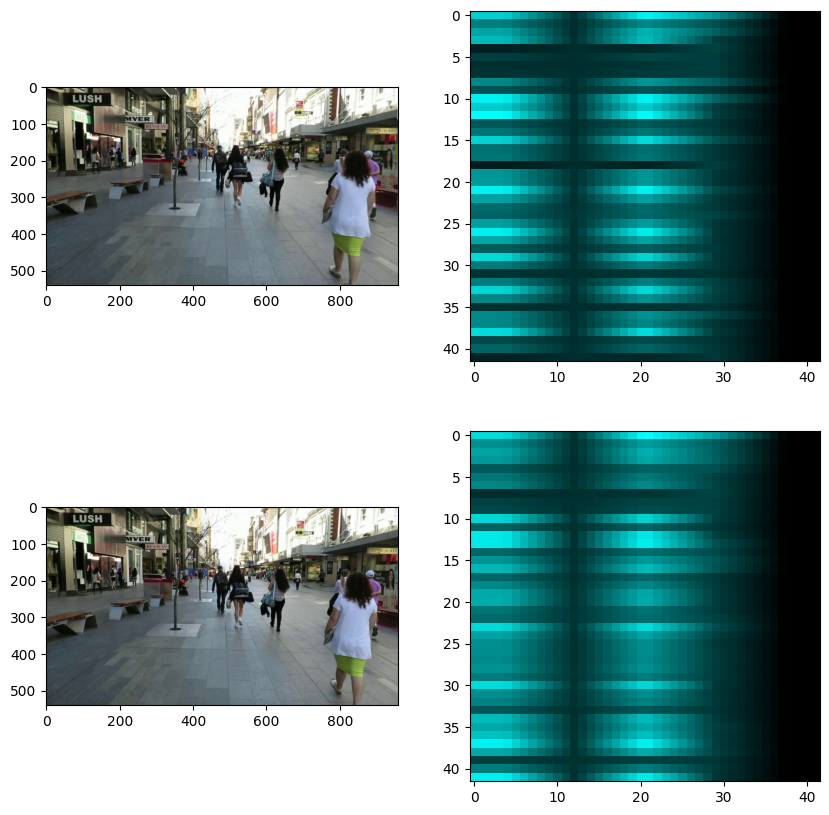

In [67]:
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
import cv2

def visualize_heatmap(heatmap):
    """
    Visualizes a single heatmap.

    Args:
        heatmap: A numpy array of shape (height, width).

    Returns:
        A numpy array of shape (height, width, 3) that can be visualized as an image.
    """
    heatmap_size = 42
    heatmap_resized = cv2.resize(heatmap, (heatmap_size, heatmap_size))
    result = np.zeros((heatmap_size, heatmap_size, 3))
    heatmap_resized = heatmap_resized / heatmap_resized.max()  # Normalize the heatmap values between 0 and 1.
    result[..., 1] = heatmap_resized  # Set the green channel to the normalized heatmap values.
    result[..., 2] = heatmap_resized  # Set the blue channel to the normalized heatmap values.
    result = (result * 255).astype(np.uint8)  # Convert the result to uint8 for display purposes.
    return result


# Load the images
img_path_1 = 'frames/frame_00000.jpg'
img_path_2 = 'frames/frame_00001.jpg'
img1 = Image.open(img_path_1)
img2 = Image.open(img_path_2)

# Run inference on both images
result_1 = inference_detector(model, img_path_1)
result_2 = inference_detector(model, img_path_2)

# Extract center heatmap predictions
center_heatmap_preds_1 = result_1[0]
center_heatmap_preds_2 = result_2[0]

# Visualize the heatmaps
heatmap_image_1 = visualize_heatmap(center_heatmap_preds_1)
heatmap_image_2 = visualize_heatmap(center_heatmap_preds_2)


# Plot the images and the heatmaps
fig, axs = plt.subplots(2, 2, figsize=(10, 10))
axs[0, 0].imshow(img1)
axs[0, 1].imshow(heatmap_image_1, cmap='jet')
axs[1, 0].imshow(img2)
axs[1, 1].imshow(heatmap_image_2, cmap='jet')
plt.show()


In [70]:
# Convert the heatmaps to binary masks
center_masks_1 = []
center_masks_2 = []
kernel_size = 5
threshold = 0.2
for i in range(center_heatmap_preds_1.shape[0]):
    #center_masks_1.append(heatmap_to_mask(center_heatmap_preds_1[i], threshold))
    center_masks_1.append(heatmap_to_mask(center_heatmap_preds_1[i], threshold, kernel_size))
for i in range(center_heatmap_preds_2.shape[0]):
    #center_masks_2.append(heatmap_to_mask(center_heatmap_preds_2[i], threshold))
    center_masks_2.append(heatmap_to_mask(center_heatmap_preds_2[i], threshold, kernel_size))

# Visualize the heatmaps and the binary masks
heatmap_image_1 = visualize_heatmap(center_heatmap_preds_1)
heatmap_image_2 = visualize_heatmap(center_heatmap_preds_2)
img1_size = img1.size  # get the size of img1
img2_size = img2.size  # get the size of img2
center_heatmap_preds_1_resized = cv2.resize(center_heatmap_preds_1, (img1_size[0], img1_size[1]))
center_heatmap_preds_2_resized = cv2.resize(center_heatmap_preds_2, (img2_size[0], img2_size[1]))
#center_masks_1.append(heatmap_to_mask(center_heatmap_preds_1[i], threshold, kernel_size))
#center_masks_2.append(heatmap_to_mask(center_heatmap_preds_2[i], threshold, kernel_size))


center_mask_1 = np.stack([cv2.resize(mask, img1.size, interpolation=cv2.INTER_NEAREST) for mask in center_masks_1], axis=-1)
center_mask_1 = np.max(center_mask_1, axis=-1) # convert to single channel mask
axs[0, 2].imshow(center_mask_1, cmap='gray')

center_mask_2 = np.stack([cv2.resize(mask, img2.size, interpolation=cv2.INTER_NEAREST) for mask in center_masks_2], axis=-1)
center_mask_2 = np.max(center_mask_2, axis=-1) # convert to single channel mask
axs[1, 2].imshow(center_mask_2, cmap='gray')

# Plot the images, the heatmaps, and the binary masks
fig, axs = plt.subplots(2, 3, figsize=(10, 10))
axs[0, 0].imshow(img1)
axs[0, 1].imshow(center_heatmap_preds_1_resized, cmap='jet')
axs[0, 2].imshow(center_mask_1, cmap='gray')
axs[1, 0].imshow(img2)
axs[1, 1].imshow(center_heatmap_preds_2_resized, cmap='jet')
axs[1, 2].imshow(center_mask_2, cmap='gray')
plt.show()
def heatmap_to_mask(heatmap, threshold):
    """
    Converts a heatmap to a binary mask using a threshold.

    Args:
        heatmap: A numpy array of shape (height, width).
        threshold: A float between 0 and 1. Pixels in the heatmap above this threshold will be set to 1,
                   and pixels below this threshold will be set to 0.

    Returns:
        A numpy array of shape (height, width) containing binary values.
    """
    kernel_size = 5
    sigma = 0
    blurred_heatmap = cv2.GaussianBlur(heatmap, (kernel_size, kernel_size), sigmaX=sigma)
    mask = np.zeros_like(blurred_heatmap)
    mask[blurred_heatmap >= threshold] = 1
    
    return mask


TypeError: ignored

In [89]:
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
import cv2

def heatmap_to_mask(heatmap, threshold):
    """
    Converts a single heatmap into a binary mask.

    Args:
        heatmap: A numpy array of shape (height, width) containing the heatmap values.
        threshold: A float representing the threshold value to use.

    Returns:
        A numpy array of shape (height, width) containing the binary mask.
    """
    mask = np.zeros_like(heatmap)
    mask[heatmap >= threshold] = 1
    return mask

def visualize_heatmap(heatmap):
    """
    Visualizes a single heatmap.

    Args:
        heatmap: A numpy array of shape (height, width).

    Returns:
        A numpy array of shape (height, width, 3) that can be visualized as an image.
    """
    heatmap_size = 42
    heatmap_resized = cv2.resize(heatmap, (heatmap_size, heatmap_size))
    result = np.zeros((heatmap_size, heatmap_size, 3))
    heatmap_resized = heatmap_resized / heatmap_resized.max()  # Normalize the heatmap values between 0 and 1.
    result[..., 1] = heatmap_resized  # Set the green channel to the normalized heatmap values.
    result[..., 2] = heatmap_resized  # Set the blue channel to the normalized heatmap values.
    result = (result * 255).astype(np.uint8)  # Convert the result to uint8 for display purposes.
    return result

# Load the images
img_path_1 = 'frames/frame_00000.jpg'
img_path_2 = 'frames/frame_00001.jpg'
img1 = Image.open(img_path_1)
img2 = Image.open(img_path_2)

# Run inference on both images
result_1 = inference_detector(model, img_path_1)
result_2 = inference_detector(model, img_path_2)

# Extract center heatmap predictions
center_heatmap_preds_1 = result_1[0]
center_heatmap_preds_2 = result_2[0]

# Convert the heatmaps to binary masks
center_masks_1 = []
center_masks_2 = []
threshold = 0.5
for i in range(center_heatmap_preds_1.shape[0]):
    center_masks_1.append(heatmap_to_mask(center_heatmap_preds_1[i], threshold))
for i in range(center_heatmap_preds_2.shape[0]):
    center_masks_2.append(heatmap_to_mask(center_heatmap_preds_2[i], threshold))

# Visualize the heatmaps and the binary masks
heatmap_image_1 = visualize_heatmap(center_heatmap_preds_1)
heatmap_image_2 = visualize_heatmap(center_heatmap_preds_2)
center_mask_1 = np.sum(center_masks_1, axis=0)
center_mask_2 = np.sum(center_masks_2, axis=0)
center_mask_1 = center_mask_1.astype(np.uint8) * 255
center_mask_2 = center_mask_2.astype(np.uint8) * 255
print([mask.shape for mask in center_masks_1])
#center_mask_1 = np.sum(center_masks_1, axis=0)
#axs[0, 2].imshow(center_mask_1, cmap='gray')

# Stack the binary masks along a new axis
#center_masks_1_stacked = np.stack(center_masks_1, axis=-1)
#center_masks_2_stacked = np.stack(center_masks_2, axis=-1)

center_masks_1_stacked = np.concatenate([np.expand_dims(mask, axis=-1) for mask in center_masks_1], axis=-1)
center_masks_2_stacked = np.concatenate([np.expand_dims(mask, axis=-1) for mask in center_masks_2], axis=-1)

#for mask in center_masks_1:
    #print(mask.shape)





[(5,), (5,), (5,), (5,), (5,), (5,), (5,), (5,), (5,), (5,), (5,), (5,), (5,), (5,), (5,), (5,), (5,), (5,), (5,), (5,), (5,), (5,), (5,), (5,), (5,), (5,), (5,), (5,), (5,), (5,), (5,), (5,), (5,), (5,), (5,), (5,), (5,), (5,), (5,), (5,), (5,), (5,)]


In [95]:
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
import cv2

def heatmap_to_mask(heatmap, threshold):
    """
    Converts a single heatmap into a binary mask.

    Args:
        heatmap: A numpy array of shape (height, width) containing the heatmap values.
        threshold: A float representing the threshold value to use.

    Returns:
        A numpy array of shape (height, width) containing the binary mask.
    """
    mask = np.zeros_like(heatmap)
    mask[heatmap >= threshold] = 1
    return mask

def visualize_heatmap(heatmap):
    """
    Visualizes a single heatmap.

    Args:
        heatmap: A numpy array of shape (height, width).

    Returns:
        A numpy array of shape (height, width, 3) that can be visualized as an image.
    """
    heatmap_size = 42
    heatmap_resized = cv2.resize(heatmap, (heatmap_size, heatmap_size))
    result = np.zeros((heatmap_size, heatmap_size, 3))
    heatmap_resized = heatmap_resized / heatmap_resized.max()  # Normalize the heatmap values between 0 and 1.
    result[..., 1] = heatmap_resized  # Set the green channel to the normalized heatmap values.
    result[..., 2] = heatmap_resized  # Set the blue channel to the normalized heatmap values.
    result = (result * 255).astype(np.uint8)  # Convert the result to uint8 for display purposes.
    return result

# Load the images
img_path_1 = 'frames/frame_00000.jpg'
img_path_2 = 'frames/frame_00001.jpg'
img1 = Image.open(img_path_1)
img2 = Image.open(img_path_2)

# Run inference on both images
result_1 = inference_detector(model, img_path_1)
result_2 = inference_detector(model, img_path_2)

# Extract center heatmap predictions
center_heatmap_preds_1 = result_1[0]
center_heatmap_preds_2 = result_2[0]

# Convert the heatmaps to binary masks
center_masks_1 = []
center_masks_2 = []
threshold = 0.5
for i in range(center_heatmap_preds_1.shape[0]):
    center_masks_1.append(heatmap_to_mask(center_heatmap_preds_1[i], threshold))
for i in range(center_heatmap_preds_2.shape[0]):
    center_masks_2.append(heatmap_to_mask(center_heatmap_preds_2[i], threshold))

# Visualize the heatmaps and the binary masks
heatmap_image_1 = visualize_heatmap(center_heatmap_preds_1)
heatmap_image_2 = visualize_heatmap(center_heatmap_preds_2)
center_mask_1 = np.sum(center_masks_1, axis=0)
center_mask_2 = np.sum(center_masks_2, axis=0)


center_mask_1 = center_mask_1.astype(np.uint8) * 255
center_mask_1 = np.expand_dims(center_mask_1, axis=2)


center_mask_2 = (center_mask_2.astype(np.uint8) * 255).squeeze()

# Show the heatmaps and the binary masks
fig, axs = plt.subplots(nrows=2, ncols=2, figsize=(10, 10))

axs[0, 0].imshow(img1)
axs[0, 0].set_title('Image 1')
axs[0, 1].imshow(heatmap_image_1)
axs[0, 1].set_title('Heatmap 1')
axs[1, 0].imshow(center_mask_1)
axs[1, 0].set_title('Center Mask 1')
axs[1, 1].imshow(img2)
axs[1, 1].set_title('Image 2')
axs[0, 0].axis('off')
axs[0, 1].axis('off')
axs[1, 0].axis('off')
axs[1, 1].axis('off')



plt.tight_layout()
plt.show()


AxisError: ignored

IndexError: ignored

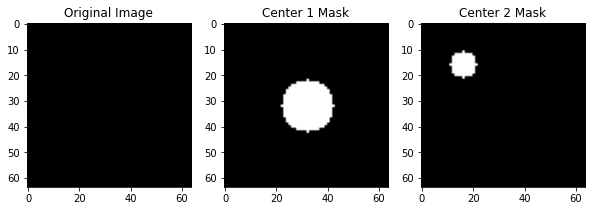

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Define the shape of the image
img_shape = (64, 64)

# Create a list of center coordinates
center_coords = [(32, 32), (16, 16), (48, 48)]

# Create a list of radii
radii = [10, 5, 5]

# Create a list of center masks
center_masks = []
for center, radius in zip(center_coords, radii):
    x, y = np.ogrid[:img_shape[0], :img_shape[1]]
    dist_from_center = np.sqrt((x - center[0])**2 + (y - center[1])**2)
    mask = dist_from_center <= radius
    center_masks.append(mask)

# Sum the center masks to create a single mask
center_mask = np.sum(center_masks, axis=0)

# Create a figure with subplots
fig, axs = plt.subplots(1, 3, figsize=(10, 4))

# Plot the original image
axs[0].imshow(np.zeros(img_shape), cmap='gray')
axs[0].set_title('Original Image')

# Plot the individual center masks
for i, mask in enumerate(center_masks):
    axs[i+1].imshow(mask, cmap='gray')
    axs[i+1].set_title(f'Center {i+1} Mask')

# Plot the combined center mask
axs[3].imshow(center_mask, cmap='gray')
axs[3].set_title('Combined Center Mask')

plt.show()


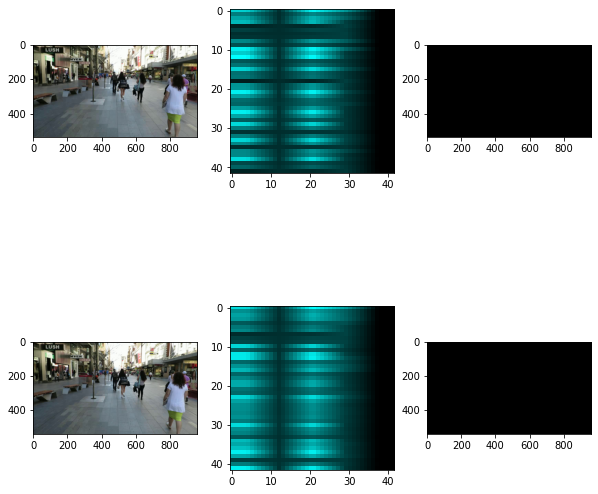

In [ ]:
# Load the images
img_path_1 = 'frames/frame_00000.jpg'
img_path_2 = 'frames/frame_00001.jpg'
img1 = Image.open(img_path_1)
img2 = Image.open(img_path_2)

# Run inference on both images
result_1 = inference_detector(model, img_path_1)
result_2 = inference_detector(model, img_path_2)

# Extract center heatmap predictions
center_heatmap_preds_1 = result_1[0]
center_heatmap_preds_2 = result_2[0]

# Convert the heatmaps to binary masks
center_masks_1 = []
center_masks_2 = []
threshold = 0.5
for i in range(center_heatmap_preds_1.shape[0]):
    center_masks_1.append(heatmap_to_mask(center_heatmap_preds_1[i], threshold))
for i in range(center_heatmap_preds_2.shape[0]):
    center_masks_2.append(heatmap_to_mask(center_heatmap_preds_2[i], threshold))

# Visualize the heatmaps and the binary masks
heatmap_image_1 = visualize_heatmap(center_heatmap_preds_1)
heatmap_image_2 = visualize_heatmap(center_heatmap_preds_2)

center_mask_1 = np.stack([cv2.resize(mask, img1.size, interpolation=cv2.INTER_NEAREST) for mask in center_masks_1], axis=-1)
center_mask_1 = np.max(center_mask_1, axis=-1) # convert to single channel mask
axs[0, 2].imshow(center_mask_1, cmap='gray')


center_mask_2 = np.stack([cv2.resize(mask, img2.size, interpolation=cv2.INTER_NEAREST) for mask in center_masks_1], axis=-1)
center_mask_2 = np.max(center_mask_2, axis=-1) # convert to single channel mask
axs[1, 2].imshow(center_mask_2, cmap='gray')


# Plot the images, the heatmaps, and the binary masks
fig, axs = plt.subplots(2, 3, figsize=(10, 10))
axs[0, 0].imshow(img1)
axs[0, 1].imshow(heatmap_image_1, cmap='jet')
axs[0, 2].imshow(center_mask_1, cmap='gray')
axs[1, 0].imshow(img2)
axs[1, 1].imshow(heatmap_image_2, cmap='jet')
axs[1, 2].imshow(center_mask_2, cmap='gray')




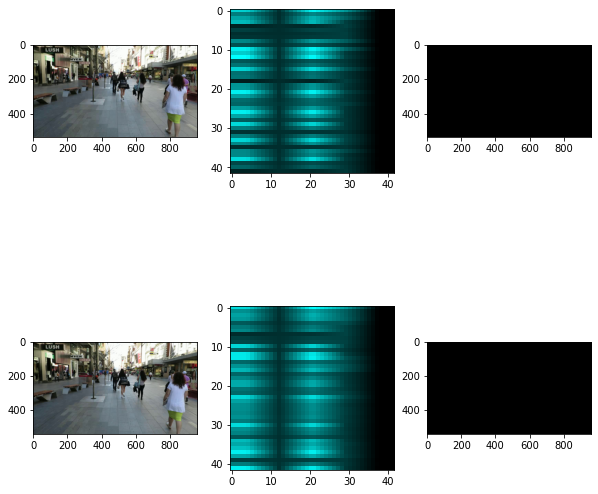

In [ ]:
# Load the images
img_path_1 = 'frames/frame_00000.jpg'
img_path_2 = 'frames/frame_00001.jpg'
img1 = Image.open(img_path_1)
img2 = Image.open(img_path_2)

# Run inference on both images
result_1 = inference_detector(model, img_path_1)
result_2 = inference_detector(model, img_path_2)

# Extract center heatmap predictions
center_heatmap_preds_1 = result_1[0]
center_heatmap_preds_2 = result_2[0]

# Convert the heatmaps to binary masks
center_masks_1 = []
center_masks_2 = []
threshold = 0.5
binary_mask_1 = np.where(center_heatmap_preds_1 >= threshold, 1, 0)
for i in range(center_heatmap_preds_1.shape[0]):
    mask = binary_mask_1[i] > threshold
    mask = mask.astype(np.uint8)
    center_masks_1.append(mask)
    
binary_mask_2 = np.where(center_heatmap_preds_2 >= threshold, 1, 0)
for i in range(center_heatmap_preds_2.shape[0]):
    mask = binary_mask_2[i] > threshold
    mask = mask.astype(np.uint8)
    center_masks_2.append(mask)

# Visualize the heatmaps and the binary masks
heatmap_image_1 = visualize_heatmap(center_heatmap_preds_1)
heatmap_image_2 = visualize_heatmap(center_heatmap_preds_2)

center_mask_1 = np.stack([cv2.resize(mask, img1.size, interpolation=cv2.INTER_NEAREST) for mask in center_masks_1], axis=-1)
center_mask_1 = np.max(center_mask_1, axis=-1) # convert to single channel mask
axs[0, 2].imshow(center_mask_1, cmap='gray')


center_mask_2 = np.stack([cv2.resize(mask, img2.size, interpolation=cv2.INTER_NEAREST) for mask in center_masks_2], axis=-1)
center_mask_2 = np.max(center_mask_2, axis=-1) # convert to single channel mask
axs[1, 2].imshow(center_mask_2, cmap='gray')


# Plot the images, the heatmaps, and the binary masks
fig, axs = plt.subplots(2, 3, figsize=(10, 10))
axs[0, 0].imshow(img1)
axs[0, 1].imshow(heatmap_image_1, cmap='jet')
axs[0, 2].imshow(center_mask_1, cmap='gray')
axs[1, 0].imshow(img2)
axs[1, 1].imshow(heatmap_image_2, cmap='jet')
axs[1, 2].imshow(center_mask_2, cmap='gray')


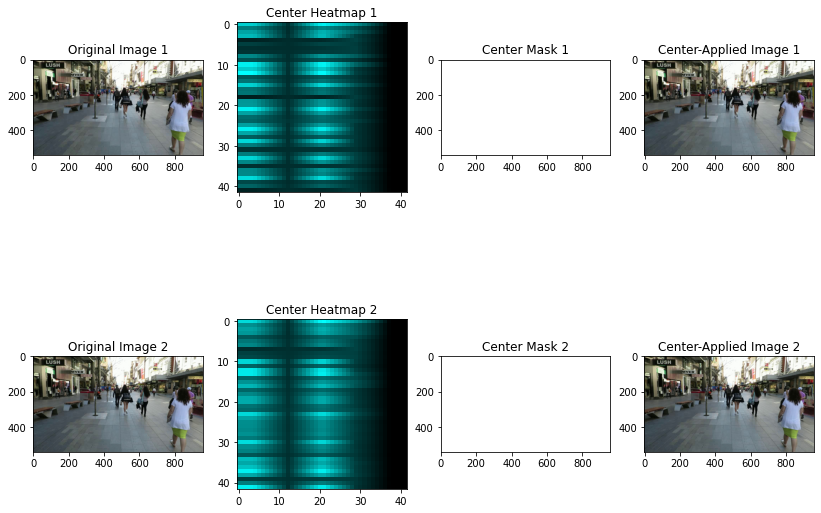

In [ ]:
# Load the images
img_path_1 = 'frames/frame_00000.jpg'
img_path_2 = 'frames/frame_00001.jpg'
img1 = Image.open(img_path_1)
img2 = Image.open(img_path_2)

# Run inference on both images
result_1 = inference_detector(model, img_path_1)
result_2 = inference_detector(model, img_path_2)

# Extract center heatmap predictions
center_heatmap_preds_1 = result_1[0]
center_heatmap_preds_2 = result_2[0]

# Convert the heatmaps to binary masks
center_masks_1 = []
center_masks_2 = []
threshold = 0.2
binary_mask = np.where(center_heatmap_preds_1 >= threshold, 1, 0)
for i in range(center_heatmap_preds_1.shape[0]):
    mask = center_heatmap_preds_1[i] > threshold
    mask = mask.astype(np.uint8)
    center_masks_1.append(mask)
binary_mask = np.where(center_heatmap_preds_2 >= threshold, 1, 0)
for i in range(center_heatmap_preds_2.shape[0]):
    mask = center_heatmap_preds_2[i] > threshold
    mask = mask.astype(np.uint8)
    center_masks_2.append(mask)

# Visualize the heatmaps and the binary masks
heatmap_image_1 = visualize_heatmap(center_heatmap_preds_1)
heatmap_image_2 = visualize_heatmap(center_heatmap_preds_2)

# Generate center masks with same size as original images
center_mask_1 = np.stack([cv2.resize(mask, img1.size, interpolation=cv2.INTER_NEAREST) for mask in center_masks_1], axis=-1)
center_mask_1 = np.max(center_mask_1, axis=-1) # convert to single channel mask

center_mask_2 = np.stack([cv2.resize(mask, img2.size, interpolation=cv2.INTER_NEAREST) for mask in center_masks_2], axis=-1)
center_mask_2 = np.max(center_mask_2, axis=-1) # convert to single channel mask

# Apply center masks to the original images
center_applied_1 = np.array(img1) * np.expand_dims(center_mask_1, axis=2)
center_applied_2 = np.array(img2) * np.expand_dims(center_mask_2, axis=2)

# Plot the images, the heatmaps, the binary masks, and the center-applied images
fig, axs = plt.subplots(2, 4, figsize=(14, 10))
axs[0, 0].imshow(img1)
axs[0, 0].set_title('Original Image 1')
axs[0, 1].imshow(heatmap_image_1, cmap='jet')
axs[0, 1].set_title('Center Heatmap 1')
axs[0, 2].imshow(center_mask_1, cmap='gray', vmin=0, vmax=1)
axs[0, 2].set_title('Center Mask 1')
axs[0, 3].imshow(center_applied_1)
axs[0, 3].set_title('Center-Applied Image 1')
axs[1, 0].imshow(img2)
axs[1, 0].set_title('Original Image 2')
axs[1, 1].imshow(heatmap_image_2, cmap='jet')
axs[1, 1].set_title('Center Heatmap 2')
axs[1, 2].imshow(center_mask_2, cmap='gray', vmin=0, vmax=1)
axs[1, 2].set_title('Center Mask 2')
axs[1, 3].imshow(center_applied_2)
axs[1, 3].set_title('Center-Applied Image 2')
plt.show()




1555200


TypeError: ignored

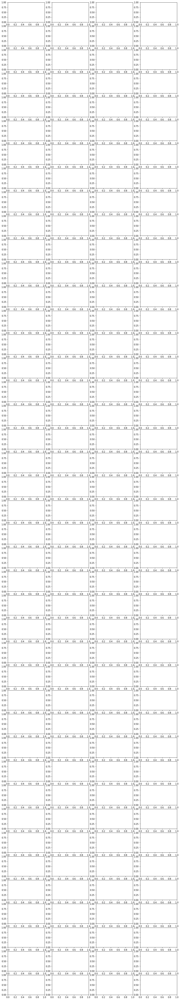

In [ ]:
print(img.size)


# Visualize the heatmaps and the binary masks for all instances
num_instances = center_heatmap_preds.shape[0]
fig, axs = plt.subplots(num_instances, 4, figsize=(14, 2*num_instances))
for i in range(num_instances):
    # Extract heatmap predictions and binary mask for the i-th instance
    heatmap_preds = center_heatmap_preds[i]
    threshold = 0.3
    binary_mask = np.where(heatmap_preds >= threshold, 1, 0).astype(np.uint8)
    
    # Convert the heatmap predictions to an image and resize it to the original image size
    heatmap_image = visualize_heatmap(heatmap_preds)
    heatmap_image = Image.fromarray(heatmap_image)
    heatmap_image = heatmap_image.resize((img.size[0], img.size[1]))

# Resize the binary mask to the original image size
    binary_mask = cv2.resize(binary_mask, (img.size[0], img.size[1]))





# Resize the binary mask to the original image size
    binary_mask = cv2.resize(binary_mask, (img.width, img.height))

    
    # Apply the binary mask to the original image
    instance_applied = np.array(img) * np.expand_dims(binary_mask, axis=2)
    
    # Plot the heatmap, binary mask, and instance-applied image
    axs[i, 0].imshow(heatmap_image, cmap='jet')
    axs[i, 0].set_title('Heatmap {}'.format(i))
    axs[i, 1].imshow(binary_mask, cmap='gray', vmin=0, vmax=1)
    axs[i, 1].set_title('Binary Mask {}'.format(i))
    axs[i, 2].imshow(instance_applied)
    axs[i, 2].set_title('Instance-Applied Image {}'.format(i))
    axs[i, 3].axis('off')
plt.show()



In [ ]:
import numpy as np
import tensorflow as tf


def visualize_heatmap(heatmaps):
    """
    Draw all heatmaps from a single picture. Heatmaps are placed into a grid, starting on left top corner and
    filling the rows as we were writing from left to right, top to bottom.

    :param heatmaps: Heatmap for a single picture, shape (size, size, labels)
    :return: picture (2D numpy array) with all heatmaps
    """
    labels = heatmaps.shape[-1]
    heatmap_size = heatmaps.shape[0]

    # grid_size
    horizontal = int(np.ceil(np.sqrt(labels)))
    vertical = int(np.ceil(float(labels) / horizontal))

    # resulting image size
    image_shape = ((heatmap_size + 1) * vertical, (heatmap_size + 1) * horizontal)

    result = np.ones(image_shape)
    for id in range(labels):
        y, x = id // horizontal, id % horizontal
        y_start, x_start = y * (heatmap_size + 1), x * (heatmap_size + 1)
        result[y_start : y_start + heatmap_size, x_start : x_start + heatmap_size] = heatmaps[:, :, id]

    return result


def draw_bounding_boxes(image, bboxes, labels, config):
    """
    Draw bounding boxes inside given image. Use colors according to the label and config.
    (To have the colors same across images and epochs.)

    :param image: 3-D Tensor of shape [height, width, channels], range 0 - 255
    :param bboxes:  2-D Tensor (box_number, 4) containing bounding boxes in format [ymin, xmin, ymin, xmax], relative c.
    :param labels: 1-D Tensor (box_number, 1) containing bounding box labels
    :param config: training configuration containing colors for the bounding boxes
    :return: image with bounding boxes
    """
    image = tf.cast(image, dtype=tf.float32)

    # draw bounding boxes on image
    if len(bboxes) > 0:
        colors = np.array([config.debug_class_colors[int(label)] for label in labels.numpy()])
        image = tf.expand_dims(image, 0)
        image = tf.image.draw_bounding_boxes(image, [bboxes], colors)[0]

    return image


def draw_heatmaps(image, heatmaps, config):
    for i in tf.range(tf.shape(heatmaps)[-1]):
        heatmap_image = heatmaps[:, :, i]
        heatmap_image = tf.expand_dims(heatmap_image, -1)
        heatmap_image = tf.image.grayscale_to_rgb(heatmap_image)
        heatmap_image = tf.image.resize(heatmap_image, (tf.shape(image)[0], tf.shape(image)[1]))

        # dim the image behind the heatmap a bit
        image *= 1.0 - tf.clip_by_value(heatmap_image * 1.1, 0.0, 1.0)

        # add the heatmap to the image
        image += heatmap_image * config.debug_class_colors[i] * 0.75

    image = tf.clip_by_value(image, 0.0, 255.0)
    return image



In [ ]:
import matplotlib.pyplot as plt
import numpy as np
# Load the image and the heatmaps
img = 'frames/frame_00000.jpg'
img2 = 'frames/frame_00001.jpg'
from PIL import Image
img = Image.open('frames/frame_00000.jpg')

import matplotlib.pyplot as plt
import numpy as np
from PIL import Image

# Load the image and the heatmaps
img_path = 'frames/frame_00000.jpg'
heatmaps = center_heatmap_preds # load heatmaps here, shape (size, size, labels)

# Load the image
img = Image.open(img_path)

# Visualize the heatmaps
heatmap_image = visualize_heatmap(heatmaps)

# Plot the image and the heatmaps
fig, axs = plt.subplots(1, 2, figsize=(10, 10))
axs[0].imshow(img)
axs[1].imshow(heatmap_image, cmap='jet')
plt.show()




IndexError: ignored

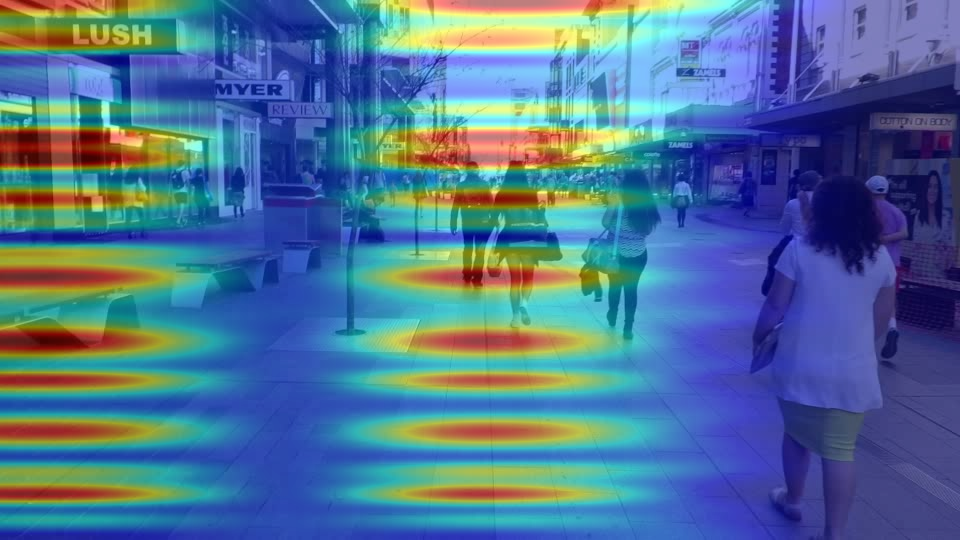

In [ ]:
import cv2
import numpy as np

# Load the image and run inference
img = cv2.imread("frames/frame_00000.jpg")
result = inference_detector(model, img)

# Get the heatmap for the first class (assuming there is only one class)
heatmap = result[0]

# Normalize the heatmap to [0, 255]
heatmap = heatmap - np.min(heatmap)
heatmap = heatmap / np.max(heatmap) * 255.0
heatmap = heatmap.astype(np.uint8)

# Resize the heatmap to the same size as the original image
heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]), interpolation=cv2.INTER_CUBIC)

# Apply a color map to the heatmap (optional)
heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)

# Overlay the heatmap on the image using alpha blending
alpha = 0.5
output = cv2.addWeighted(img, 1-alpha, heatmap, alpha, 0)

# Display the result
cv2_imshow(output)
cv2.waitKey(0)
cv2.destroyAllWindows()

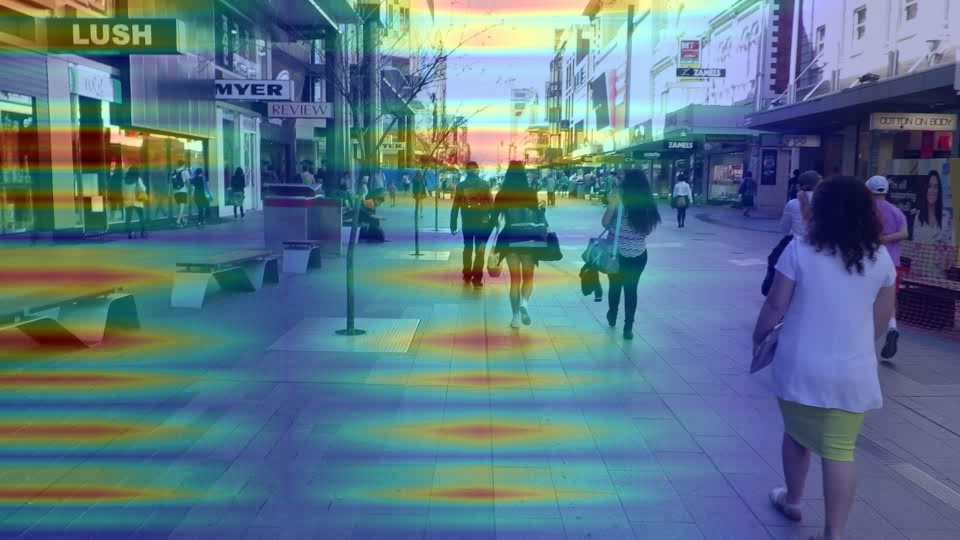

In [ ]:
import cv2
import numpy as np

# assume 'result' is the output of the CenterNet model, containing the heatmap
center_heatmap_preds = result[0]

# resize the heatmap to the same size as the input image
resized_heatmap = cv2.resize(center_heatmap_preds, (img.shape[1], img.shape[0]), interpolation=cv2.INTER_LINEAR)

# normalize the heatmap to 0-255 range
resized_heatmap = (resized_heatmap - np.min(resized_heatmap)) / (np.max(resized_heatmap) - np.min(resized_heatmap)) * 255
resized_heatmap = resized_heatmap.astype(np.uint8)

# convert the heatmap to a color map
heatmap_colormap = cv2.applyColorMap(resized_heatmap, cv2.COLORMAP_JET)

# blend the heatmap with the input image using alpha blending
alpha = 0.7  # adjust the transparency of the heatmap
result_img = cv2.addWeighted(img, alpha, heatmap_colormap, 1-alpha, 0)

# display the result image
cv2_imshow(result_img)
cv2.waitKey(0)
cv2.destroyAllWindows()



In [ ]:
import cv2
import numpy as np

# Load the image and run inference
img = cv2.imread("frames/frame_00000.jpg")
result = inference_detector(model, img)

# Get the heatmap for the first class (assuming there is only one class)
heatmap = result[-1]

# Normalize the heatmap to [0, 255]
heatmap = heatmap - np.min(heatmap)
heatmap = heatmap / np.max(heatmap) * 255.0
heatmap = heatmap.astype(np.uint8)

# Resize the heatmap to the same size as the original image
heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]), interpolation=cv2.INTER_CUBIC)

# Apply a color map to the heatmap (optional)
heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)

# Overlay the heatmap on the image using alpha blending
alpha = 0.3
output = cv2.addWeighted(img, 1-alpha, heatmap, alpha, 0)

# Display the result
cv2_imshow(output)
cv2.waitKey(0)
cv2.destroyAllWindows()


/usr/local/lib/python3.9/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)
/usr/local/lib/python3.9/dist-packages/torch/_tensor.py:575: UserWarning: floor_divide is deprecated, and will be removed in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values.
To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor'). (Triggered internally at  /pytorch/aten/src/ATen/native/BinaryOps.cpp:467.)
  return torch.floor_divide(self, other)


ValueError: ignored

In [ ]:
import cv2
import numpy as np

# Load the image and run inference
img = cv2.imread("frames/frame_00000.jpg")
results = inference_detector(model, img)

# Get the heatmaps for all detected objects
heatmaps = results[-1]

# Loop over each heatmap and visualize it on top of the original image
for i in range(len(heatmaps)):
    heatmap = heatmaps[i]
    # Normalize the heatmap to [0, 255]
    heatmap = heatmap - np.min(heatmap)
    heatmap = heatmap / np.max(heatmap) * 255.0
    heatmap = heatmap.astype(np.uint8)

    # Resize the heatmap to the same size as the original image
    heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]), interpolation=cv2.INTER_CUBIC)

    # Apply a color map to the heatmap
    heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)

    # Overlay the heatmap on the image using alpha blending
    alpha = 0.5
    output = cv2.addWeighted(img, 1-alpha, heatmap, alpha, 0)

    # Display the result
    cv2.imshow("Heatmap for Object {}".format(i), output)

cv2.waitKey(0)


-1

In [ ]:
center_heatmap_preds = result[0]['heatmap']
img_h, img_w = result[0]['img_shape'][:2]
resized_heatmap = cv2.resize(center_heatmap_preds, (img_w, img_h), interpolation=cv2.INTER_LINEAR)
resized_heatmap = (resized_heatmap - np.min(resized_heatmap)) / (np.max(resized_heatmap) - np.min(resized_heatmap)) * 255
resized_heatmap = resized_heatmap.astype(np.uint8)
heatmap_colormap = cv2.applyColorMap(resized_heatmap, cv2.COLORMAP_JET)
alpha = 0.7
result_img = cv2.addWeighted(img, alpha, heatmap_colormap, 1-alpha, 0)
result = inference_detector(model, img)
print(result.keys())



IndexError: ignored

In [ ]:
import cv2
import numpy as np

# Load the original image
img = cv2.imread("frames/frame_00000.jpg")

# Load the heatmap
center_heatmap_preds = cv2.imread("path/to/heatmap.jpg", cv2.IMREAD_GRAYSCALE)

# Normalize the heatmap
center_heatmap_preds = center_heatmap_preds - np.min(center_heatmap_preds)
center_heatmap_preds = center_heatmap_preds / np.max(center_heatmap_preds)
center_heatmap_preds = (center_heatmap_preds * 255).astype(np.uint8)

# Resize the heatmap to the same size as the original image
resized_heatmap = cv2.resize(center_heatmap_preds, (img.shape[1], img.shape[0]), interpolation=cv2.INTER_CUBIC)

# Apply the heatmap on top of the original image using alpha blending
heatmap_overlay = cv2.applyColorMap(resized_heatmap, cv2.COLORMAP_JET)
heatmap_overlay = cv2.addWeighted(img, 0.5, heatmap_overlay, 0.5, 0)

# Display the result
cv2.imshow("Heatmap Overlay", heatmap_overlay)
cv2.waitKey(0)
cv2.destroyAllWindows()




# Normalize the heatmap values to a range between 0 and 1
normalized_heatmap_1 = cv2.normalize(center_heatmap_preds_1, None, 0, 1, cv2.NORM_MINMAX)

# Convert the heatmap values to a color map
colored_heatmap_1 = cv2.applyColorMap(np.uint8(255 * normalized_heatmap_1), cv2.COLORMAP_JET)

# Adjust the contrast and brightness of the heatmap
alpha = 1.5
beta = 10
heatmap_1 = cv2.convertScaleAbs(colored_heatmap_1, alpha=alpha, beta=beta)

# Show the heatmap
cv2_imshow(heatmap_1)
cv2.waitKey(0)
cv2.destroyAllWindows()

TypeError: ignored

In [ ]:
resized_heatmap = cv2.resize(heatmap, (heatmap.shape[1]*20, heatmap.shape[0]*25), interpolation = cv2.INTER_CUBIC)
print(resized_heatmap/256)
cv2_imshow(resized_heatmap)
cv2.imwrite("heatmap1.jpg", heatmap)

resized_heatmap_1 = cv2.resize(heatmap_1, (heatmap_1.shape[1]*20, heatmap_1.shape[0]*25), interpolation = cv2.INTER_CUBIC)
print(resized_heatmap_1/256)
cv2_imshow(resized_heatmap_1)
cv2.imwrite("heatmap2.jpg", heatmap_1)
cv2.waitKey(0)
cv2.destroyAllWindows()

[[[0.       0.       0.9375  ]
  [0.       0.       0.9375  ]
  [0.       0.       0.9375  ]
  ...
  [0.5      0.       0.      ]
  [0.5      0.       0.      ]
  [0.5      0.       0.      ]]

 [[0.       0.       0.9375  ]
  [0.       0.       0.9375  ]
  [0.       0.       0.9375  ]
  ...
  [0.5      0.       0.      ]
  [0.5      0.       0.      ]
  [0.5      0.       0.      ]]

 [[0.       0.       0.9375  ]
  [0.       0.       0.9375  ]
  [0.       0.       0.9375  ]
  ...
  [0.5      0.       0.      ]
  [0.5      0.       0.      ]
  [0.5      0.       0.      ]]

 ...

 [[0.890625 0.       0.      ]
  [0.890625 0.       0.      ]
  [0.890625 0.       0.      ]
  ...
  [0.5      0.       0.      ]
  [0.5      0.       0.      ]
  [0.5      0.       0.      ]]

 [[0.890625 0.       0.      ]
  [0.890625 0.       0.      ]
  [0.890625 0.       0.      ]
  ...
  [0.5      0.       0.      ]
  [0.5      0.       0.      ]
  [0.5      0.       0.      ]]

 [[0.890625 0.       0. 

NameError: ignored

In [ ]:
import numpy as np
from sklearn.metrics.pairwise import cosine_similarity
import cv2

heatmap = cv2.imread("heatmap1.jpg", 0) # read the first heatmap
heatmap_1 = cv2.imread("heatmap2.jpg", 0) # read the second heatmap

# resize the heatmaps to a common size, if they are of different sizes
resized_heatmap = cv2.resize(heatmap, (heatmap.shape[1]*20, heatmap.shape[0]*25), interpolation = cv2.INTER_CUBIC)
resized_heatmap_1 = cv2.resize(heatmap_1, (heatmap_1.shape[1]*20, heatmap_1.shape[0]*25), interpolation = cv2.INTER_CUBIC)

# flatten the heatmaps into 1D arrays
heatmap_vector = resized_heatmap.flatten()
heatmap_vector_1 = resized_heatmap_1.flatten()

# calculate the cosine similarity between the two heatmaps
cosine_sim = cosine_similarity(heatmap_vector.reshape(1, -1), heatmap_vector_1.reshape(1, -1))
print("Cosine Similarity: ", cosine_sim[0][0])



ValueError: ignored

In [ ]:
height, width = heatmap.shape[0], heatmap.shape[1]
height_1, width_1 = heatmap_1.shape[0], heatmap_1.shape[1]

if height != height_1 or width != width_1:
    if height > height_1:
        heatmap_1 = cv2.resize(heatmap_1, (width, height), interpolation = cv2.INTER_CUBIC)
    else:
        heatmap = cv2.resize(heatmap, (width_1, height_1), interpolation = cv2.INTER_CUBIC)

cosine_sim = cosine_similarity(heatmap.reshape(1, -1), heatmap_1.reshape(1, -1))
print("Cosine Similarity: ", cosine_sim[0][0])


Cosine Similarity:  0.9448194826748761


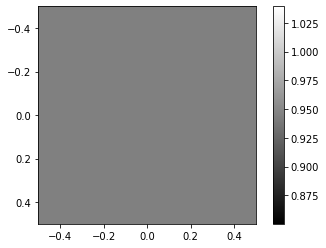

In [ ]:
# Create a heatmap of the cosine similarity values
plt.imshow(cosine_sim, cmap='gray')

# Add a colorbar to indicate the scale of the similarity values
plt.colorbar()

# Show the plot
plt.show()

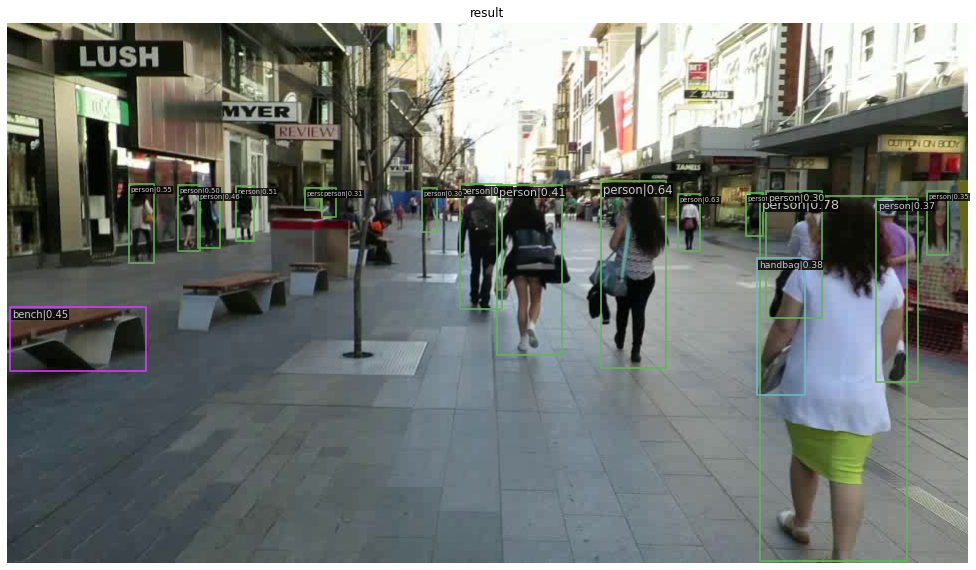

[[7.99483597e-01 1.84221998e-01 9.56342876e-01 5.72546363e-01
  6.90521323e-04]
 [4.80930239e-01 1.71854213e-01 5.25763392e-01 3.04904491e-01
  6.32292300e-04]
 [6.30716026e-01 1.68413118e-01 7.00093389e-01 3.66934299e-01
  5.40124311e-04]
 [7.12574661e-01 1.82218179e-01 7.35471010e-01 2.43151501e-01
  5.22039947e-04]
 [1.28480688e-01 1.71007499e-01 1.55912548e-01 2.55882114e-01
  4.39115771e-04]
 [2.42361709e-01 1.73460275e-01 2.62347460e-01 2.32046127e-01
  4.02531063e-04]
 [1.81386277e-01 1.72511175e-01 2.04063371e-01 2.42382795e-01
  3.87541542e-04]
 [2.02383995e-01 1.78876013e-01 2.25585282e-01 2.39235491e-01
  3.47685476e-04]
 [5.20107985e-01 1.72796190e-01 5.89386642e-01 3.53445619e-01
  2.94406229e-04]
 [3.16083163e-01 1.75454512e-01 3.32565963e-01 1.99048311e-01
  2.51647551e-04]
 [9.23332512e-01 1.87961340e-01 9.67298210e-01 3.81592989e-01
  2.50683021e-04]
 [7.85276830e-01 1.81543157e-01 8.02502692e-01 2.27050006e-01
  2.46537442e-04]
 [9.77710485e-01 1.78685516e-01 1.000000

In [ ]:
import cv2
import numpy as np
import torch
# Let's plot the result
from google.colab.patches import cv2_imshow
show_result_pyplot(model, img, result, score_thr=0.3)


#print(center_heatmap_preds)

#print(center_heatmap_target)
center_heatmap_preds = center_heatmap_preds- np.min(center_heatmap_preds)
center_heatmap_preds = center_heatmap_preds / np.max(center_heatmap_preds)
#cv2_imshow(center_heatmap_preds)
# Convert the heatmap to an 8-bit unsigned integer representation
#center_heatmap_preds = (center_heatmap_preds * 255).astype(np.uint8)
print(center_heatmap_preds)
# Display the heatmap
cv2_imshow(center_heatmap_preds)

import matplotlib.pyplot as plt

#plt.show()
#cv2.destroyAllWindows()





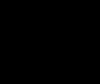

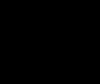

In [ ]:
center_heatmap_preds = center_heatmap_preds - np.min(center_heatmap_preds)
center_heatmap_preds = center_heatmap_preds / np.max(center_heatmap_preds)
cv2_imshow(center_heatmap_preds)
resized_heatmap = cv2.resize(center_heatmap_preds, (center_heatmap_preds.shape[1]*20, center_heatmap_preds.shape[0]*2), interpolation = cv2.INTER_CUBIC)
cv2_imshow(resized_heatmap)
cv2.waitKey(0)
cv2.destroyAllWindows()
cv2_imshow(resized_heatmap)
cv2.waitKey(0)
cv2.destroyAllWindows()

In [ ]:
import cv2
import numpy as np
img_path = 'demo/1.png'
# get heat map from the model's output tensor
heat_map = model.predict(result)

# normalize heat map
heat_map = heat_map - np.min(heat_map)
heat_map = heat_map / np.max(heat_map)

# display heat map using OpenCV
cv2.imshow("Heat Map", heat_map)
cv2.waitKey(0)
cv2.destroyAllWindows()


AttributeError: ignored

## Train A Detector on A Customized Dataset

To train a new detector, there are usually three things to do:
1. Support a new dataset
2. Modify the config
3. Train a new detector



### Support a new dataset

There are three ways to support a new dataset in MMDetection: 
  1. Reorganize the dataset into a COCO format.
  2. Reorganize the dataset into a middle format.
  3. Implement a new dataset.

We recommend the first two methods, as they are usually easier than the third one.

In this tutorial, we give an example that converts the data into the formats of existing datasets, e.g. COCO, VOC, etc. Other methods and more advanced usages can be found in the [doc](https://mmdetection.readthedocs.io/en/latest/tutorials/customize_dataset.html#).

First, let's download a tiny dataset obtained from [KITTI](http://www.cvlibs.net/datasets/kitti/eval_object.php?obj_benchmark=3d). We select the first 75 images and their annotations from the 3D object detection dataset (it is the same dataset as the 2D object detection dataset but with 3D annotations). We convert the original images from PNG to JPEG format with 80% quality to reduce the size of the dataset.

In [ ]:
# download, decompress the data
!wget https://download.openmmlab.com/mmdetection/data/kitti_tiny.zip
!unzip kitti_tiny.zip > /dev/null

--2022-02-08 11:33:06--  https://download.openmmlab.com/mmdetection/data/kitti_tiny.zip
Resolving download.openmmlab.com (download.openmmlab.com)... 47.245.16.66
Connecting to download.openmmlab.com (download.openmmlab.com)|47.245.16.66|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 6918271 (6.6M) [application/zip]
Saving to: ‘kitti_tiny.zip’

kitti_tiny.zip      100%[===================>]   6.60M  4.69MB/s    in 1.4s    

2022-02-08 11:33:09 (4.69 MB/s) - ‘kitti_tiny.zip’ saved [6918271/6918271]



In [ ]:
# Check the directory structure of the tiny data

# Install tree first
!apt-get -q install tree
!tree kitti_tiny

Reading package lists...
Building dependency tree...
Reading state information...
The following packages were automatically installed and are no longer required:
  cuda-command-line-tools-10-0 cuda-command-line-tools-10-1
  cuda-command-line-tools-11-0 cuda-compiler-10-0 cuda-compiler-10-1
  cuda-compiler-11-0 cuda-cuobjdump-10-0 cuda-cuobjdump-10-1
  cuda-cuobjdump-11-0 cuda-cupti-10-0 cuda-cupti-10-1 cuda-cupti-11-0
  cuda-cupti-dev-11-0 cuda-documentation-10-0 cuda-documentation-10-1
  cuda-documentation-11-0 cuda-documentation-11-1 cuda-gdb-10-0 cuda-gdb-10-1
  cuda-gdb-11-0 cuda-gpu-library-advisor-10-0 cuda-gpu-library-advisor-10-1
  cuda-libraries-10-0 cuda-libraries-10-1 cuda-libraries-11-0
  cuda-memcheck-10-0 cuda-memcheck-10-1 cuda-memcheck-11-0 cuda-nsight-10-0
  cuda-nsight-10-1 cuda-nsight-11-0 cuda-nsight-11-1 cuda-nsight-compute-10-0
  cuda-nsight-compute-10-1 cuda-nsight-compute-11-0 cuda-nsight-compute-11-1
  cuda-nsight-systems-10-1 cuda-nsight-systems-11-0 cuda-nsig

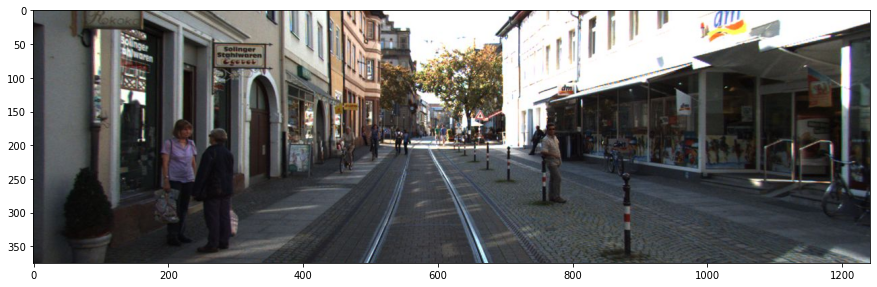

In [ ]:
# Let's take a look at the dataset image
import mmcv
import matplotlib.pyplot as plt

img = mmcv.imread('kitti_tiny/training/image_2/000073.jpeg')
plt.figure(figsize=(15, 10))
plt.imshow(mmcv.bgr2rgb(img))
plt.show()

After downloading the data, we need to implement a function to convert the KITTI annotation format into the middle format. In this tutorial, we choose to convert them in **`load_annotations`** function in a newly implemented **`KittiTinyDataset`**.

Let's take a loot at the annotation txt file.



In [ ]:
# Check the label of a single image
!cat kitti_tiny/training/label_2/000000.txt

Pedestrian 0.00 0 -0.20 712.40 143.00 810.73 307.92 1.89 0.48 1.20 1.84 1.47 8.41 0.01


According to the KITTI's documentation, the first column indicates the class of the object, and the 5th to 8th columns indicate the bboxes. We need to read annotations of each image and convert them into middle format that MMDetection can accept, as follows:

```python
[
    {
        'filename': 'a.jpg',
        'width': 1280,
        'height': 720,
        'ann': {
            'bboxes': <np.ndarray> (n, 4) in (x1, y1, x2, y2) order,
            'labels': <np.ndarray> (n, ),
            'bboxes_ignore': <np.ndarray> (k, 4), (optional field)
            'labels_ignore': <np.ndarray> (k, 4) (optional field)
        }
    },
    ...
]
```

In [ ]:
import copy
import os.path as osp

import mmcv
import numpy as np

from mmdet.datasets.builder import DATASETS
from mmdet.datasets.custom import CustomDataset

@DATASETS.register_module()
class KittiTinyDataset(CustomDataset):

    CLASSES = ('Car', 'Pedestrian', 'Cyclist')

    def load_annotations(self, ann_file):
        cat2label = {k: i for i, k in enumerate(self.CLASSES)}
        # load image list from file
        image_list = mmcv.list_from_file(self.ann_file)
    
        data_infos = []
        # convert annotations to middle format
        for image_id in image_list:
            filename = f'{self.img_prefix}/{image_id}.jpeg'
            image = mmcv.imread(filename)
            height, width = image.shape[:2]
    
            data_info = dict(filename=f'{image_id}.jpeg', width=width, height=height)
    
            # load annotations
            label_prefix = self.img_prefix.replace('image_2', 'label_2')
            lines = mmcv.list_from_file(osp.join(label_prefix, f'{image_id}.txt'))
    
            content = [line.strip().split(' ') for line in lines]
            bbox_names = [x[0] for x in content]
            bboxes = [[float(info) for info in x[4:8]] for x in content]
    
            gt_bboxes = []
            gt_labels = []
            gt_bboxes_ignore = []
            gt_labels_ignore = []
    
            # filter 'DontCare'
            for bbox_name, bbox in zip(bbox_names, bboxes):
                if bbox_name in cat2label:
                    gt_labels.append(cat2label[bbox_name])
                    gt_bboxes.append(bbox)
                else:
                    gt_labels_ignore.append(-1)
                    gt_bboxes_ignore.append(bbox)

            data_anno = dict(
                bboxes=np.array(gt_bboxes, dtype=np.float32).reshape(-1, 4),
                labels=np.array(gt_labels, dtype=np.long),
                bboxes_ignore=np.array(gt_bboxes_ignore,
                                       dtype=np.float32).reshape(-1, 4),
                labels_ignore=np.array(gt_labels_ignore, dtype=np.long))

            data_info.update(ann=data_anno)
            data_infos.append(data_info)

        return data_infos

### Modify the config

In the next step, we need to modify the config for the training.
To accelerate the process, we finetune a detector using a pre-trained detector.

In [ ]:
from mmcv import Config
cfg = Config.fromfile('./configs/faster_rcnn/faster_rcnn_r50_caffe_fpn_mstrain_1x_coco.py')

Given a config that trains a Faster R-CNN on COCO dataset, we need to modify some values to use it for training Faster R-CNN on KITTI dataset. We modify the config of datasets, learning rate schedules, and runtime settings.

In [ ]:
from mmdet.apis import set_random_seed

# Modify dataset type and path
cfg.dataset_type = 'KittiTinyDataset'
cfg.data_root = 'kitti_tiny/'

cfg.data.test.type = 'KittiTinyDataset'
cfg.data.test.data_root = 'kitti_tiny/'
cfg.data.test.ann_file = 'train.txt'
cfg.data.test.img_prefix = 'training/image_2'

cfg.data.train.type = 'KittiTinyDataset'
cfg.data.train.data_root = 'kitti_tiny/'
cfg.data.train.ann_file = 'train.txt'
cfg.data.train.img_prefix = 'training/image_2'

cfg.data.val.type = 'KittiTinyDataset'
cfg.data.val.data_root = 'kitti_tiny/'
cfg.data.val.ann_file = 'val.txt'
cfg.data.val.img_prefix = 'training/image_2'

# modify num classes of the model in box head
cfg.model.roi_head.bbox_head.num_classes = 3
# If we need to finetune a model based on a pre-trained detector, we need to
# use load_from to set the path of checkpoints.
cfg.load_from = 'checkpoints/faster_rcnn_r50_caffe_fpn_mstrain_3x_coco_20210526_095054-1f77628b.pth'

# Set up working dir to save files and logs.
cfg.work_dir = './tutorial_exps'

# The original learning rate (LR) is set for 8-GPU training.
# We divide it by 8 since we only use one GPU.
cfg.optimizer.lr = 0.02 / 8
cfg.lr_config.warmup = None
cfg.log_config.interval = 10

# Change the evaluation metric since we use customized dataset.
cfg.evaluation.metric = 'mAP'
# We can set the evaluation interval to reduce the evaluation times
cfg.evaluation.interval = 12
# We can set the checkpoint saving interval to reduce the storage cost
cfg.checkpoint_config.interval = 12

# Set seed thus the results are more reproducible
cfg.seed = 0
set_random_seed(0, deterministic=False)
cfg.gpu_ids = range(1)

# We can also use tensorboard to log the training process
cfg.log_config.hooks = [
    dict(type='TextLoggerHook'),
    dict(type='TensorboardLoggerHook')]


# We can initialize the logger for training and have a look
# at the final config used for training
print(f'Config:\n{cfg.pretty_text}')


Config:
model = dict(
    type='FasterRCNN',
    backbone=dict(
        type='ResNet',
        depth=50,
        num_stages=4,
        out_indices=(0, 1, 2, 3),
        frozen_stages=1,
        norm_cfg=dict(type='BN', requires_grad=False),
        norm_eval=True,
        style='caffe',
        init_cfg=dict(
            type='Pretrained',
            checkpoint='open-mmlab://detectron2/resnet50_caffe')),
    neck=dict(
        type='FPN',
        in_channels=[256, 512, 1024, 2048],
        out_channels=256,
        num_outs=5),
    rpn_head=dict(
        type='RPNHead',
        in_channels=256,
        feat_channels=256,
        anchor_generator=dict(
            type='AnchorGenerator',
            scales=[8],
            ratios=[0.5, 1.0, 2.0],
            strides=[4, 8, 16, 32, 64]),
        bbox_coder=dict(
            type='DeltaXYWHBBoxCoder',
            target_means=[0.0, 0.0, 0.0, 0.0],
            target_stds=[1.0, 1.0, 1.0, 1.0]),
        loss_cls=dict(
            type='Cro

### Train a new detector

Finally, lets initialize the dataset and detector, then train a new detector! We use the high-level API `train_detector` implemented by MMDetection. This is also used in our training scripts. For details of the implementation, please see [here](https://github.com/open-mmlab/mmdetection/blob/master/mmdet/apis/train.py).

In [ ]:
from mmdet.datasets import build_dataset
from mmdet.models import build_detector
from mmdet.apis import train_detector


# Build dataset
datasets = [build_dataset(cfg.data.train)]

# Build the detector
model = build_detector(cfg.model)
# Add an attribute for visualization convenience
model.CLASSES = datasets[0].CLASSES

# Create work_dir
mmcv.mkdir_or_exist(osp.abspath(cfg.work_dir))
train_detector(model, datasets, cfg, distributed=False, validate=True)

/content/mmdetection/mmdet/datasets/custom.py:180: UserWarning: CustomDataset does not support filtering empty gt images.
  'CustomDataset does not support filtering empty gt images.')
2022-02-08 11:38:22,273 - mmdet - INFO - load checkpoint from local path: checkpoints/faster_rcnn_r50_caffe_fpn_mstrain_3x_coco_20210526_095054-1f77628b.pth
2022-02-08 11:38:22,406 - mmdet - WARNING - The model and loaded state dict do not match exactly

size mismatch for roi_head.bbox_head.fc_cls.weight: copying a param with shape torch.Size([81, 1024]) from checkpoint, the shape in current model is torch.Size([4, 1024]).
size mismatch for roi_head.bbox_head.fc_cls.bias: copying a param with shape torch.Size([81]) from checkpoint, the shape in current model is torch.Size([4]).
size mismatch for roi_head.bbox_head.fc_reg.weight: copying a param with shape torch.Size([320, 1024]) from checkpoint, the shape in current model is torch.Size([12, 1024]).
size mismatch for roi_head.bbox_head.fc_reg.bias: copyin

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 25/25, 9.7 task/s, elapsed: 3s, ETA:     0s
---------------iou_thr: 0.5---------------


2022-02-08 11:40:51,306 - mmdet - INFO - 
+------------+-----+------+--------+-------+
| class      | gts | dets | recall | ap    |
+------------+-----+------+--------+-------+
| Car        | 62  | 129  | 0.968  | 0.869 |
| Pedestrian | 13  | 38   | 0.846  | 0.752 |
| Cyclist    | 7   | 51   | 0.571  | 0.123 |
+------------+-----+------+--------+-------+
| mAP        |     |      |        | 0.581 |
+------------+-----+------+--------+-------+
2022-02-08 11:40:51,309 - mmdet - INFO - Epoch(val) [12][25]	AP50: 0.5810, mAP: 0.5813


### Understand the log
From the log, we can have a basic understanding on the training process and know how well the detector is trained.

First, since the dataset we are using is small, we loaded a pre-trained Faster R-CNN model and fine-tune it for detection. 
The original Faster R-CNN is trained on COCO dataset that contains 80 classes but KITTI Tiny dataset only have 3 classes. Therefore, the last FC layers of the pre-trained Faster R-CNN for classification and regression have different weight shape and are not used.

Second, after training, the detector is evaluated by the default VOC-style evaluation. The results show that the detector achieves 58.1 mAP on the val dataset, not bad!

We can also check the tensorboard to see the curves.

In [ ]:
# load tensorboard in colab
%load_ext tensorboard

# see curves in tensorboard
%tensorboard --logdir ./tutorial_exps

<IPython.core.display.Javascript object>

From the tensorboard, we can observe that changes of loss and learning rate. We can see the losses of each branch gradually decrease as the training goes by.

## Test the Trained Detector

After finetuning the detector, let's visualize the prediction results!

/content/mmdetection/mmdet/datasets/utils.py:69: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  'data pipeline in your config file.', UserWarning)


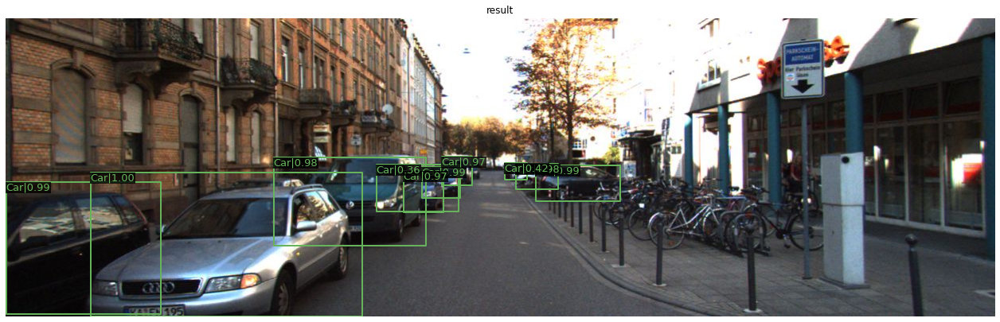

In [ ]:
img = mmcv.imread('kitti_tiny/training/image_2/000068.jpeg')

model.cfg = cfg
result = inference_detector(model, img)
show_result_pyplot(model, img, result)


## What to Do Next?

So far, we have learnt how to test and train a two-stage detector using MMDetection. To further explore MMDetection, you could do several other things as shown below:

- Try single-stage detectors, e.g., [RetinaNet](https://github.com/open-mmlab/mmdetection/tree/master/configs/retinanet) and [SSD](https://github.com/open-mmlab/mmdetection/tree/master/configs/ssd) in [MMDetection model zoo](https://github.com/open-mmlab/mmdetection/blob/master/docs/en/model_zoo.md). Single-stage detectors are more commonly used than two-stage detectors in industry.
- Try anchor-free detectors, e.g., [FCOS](https://github.com/open-mmlab/mmdetection/tree/master/configs/fcos) and [RepPoints](https://github.com/open-mmlab/mmdetection/tree/master/configs/reppoints) in [MMDetection model zoo](https://github.com/open-mmlab/mmdetection/blob/master/docs/en/model_zoo.md). Anchor-free detector is a new trend in the object detection community.
- Try 3D object detection using [MMDetection3D](https://github.com/open-mmlab/mmdetection3d), also one of the OpenMMLab projects. In MMDetection3D, not only can you try all the methods supported in MMDetection but also some 3D object detectors.
